In [2]:
import pandas as pd
import numpy as np
import psycopg2 as pg
import matplotlib.pyplot as plt
from dotenv import dotenv_values

Hinweis: Eventuell weichen die Farben und Bezeichnungen von der Ausarbeitung ab da je nach Durchlauf die Klassen unterschiedliche Farben und Zuordnungen bekommen

In [3]:
config = dotenv_values("../.env")
postgres_user = config["postgres_user"]
postgres_pw = config["postgres_pw"]
postgres_port = '5432'

df = pd.read_csv("../data/master_data/data.csv")
df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liked
0,0.803,0.6240,7,-6.764,0,0.0477,0.4510,0.000734,0.1000,0.6280,95.968,304524,4,0
1,0.762,0.7030,10,-7.951,0,0.3060,0.2060,0.000000,0.0912,0.5190,151.329,247178,4,1
2,0.261,0.0149,1,-27.528,1,0.0419,0.9920,0.897000,0.1020,0.0382,75.296,286987,4,0
3,0.722,0.7360,3,-6.994,0,0.0585,0.4310,0.000001,0.1230,0.5820,89.860,208920,4,1
4,0.787,0.5720,1,-7.516,1,0.2220,0.1450,0.000000,0.0753,0.6470,155.117,179413,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,0.166,0.0551,9,-19.494,0,0.0520,0.9760,0.635000,0.1190,0.1430,176.616,206520,3,0
191,0.862,0.6240,3,-11.630,1,0.0565,0.0192,0.000153,0.0465,0.8820,124.896,254240,4,0
192,0.499,0.3510,9,-11.509,0,0.0448,0.9510,0.000099,0.1180,0.6160,90.664,235947,4,0
193,0.574,0.7290,10,-5.838,0,0.0965,0.0406,0.000004,0.1940,0.4130,110.547,190239,5,1


### Visualisation

In [3]:
def plot_scatter_2_features(f1: str,  f2 : str)-> None:
    colors = ["blue" if x == 1 else "red" for x in df["mode"]] 
    plt.scatter(df[f1] , df[f2], c=colors)
    plt.title(f1 + " " + f2 )
    plt.xlabel(f1)
    plt.ylabel(f2)
    plt.show()

def plot_all_features() -> None:

    fig, axs = plt.subplots(len(df.columns) , len(df.columns) , figsize=(150, 150)) # , sharex=True, sharey=True)
    cols = df.columns
    rows = df.columns
    colors = ["blue" if x == 1 else "red" for x in df["mode"]] 
        
    for ax, col in zip(axs[0], cols):
        ax.set_title(col)
    
    for ax, row in zip(axs[:,0], rows):
        ax.set_ylabel(row, rotation=90, size='large')
    
    for i in range(len(df.columns)):
        for j in range(len(df.columns)):
            axs[i,j].scatter(df[df.columns[i]], df[df.columns[j]] , c=colors)


    plt.savefig("./all_scatterplots.png" )


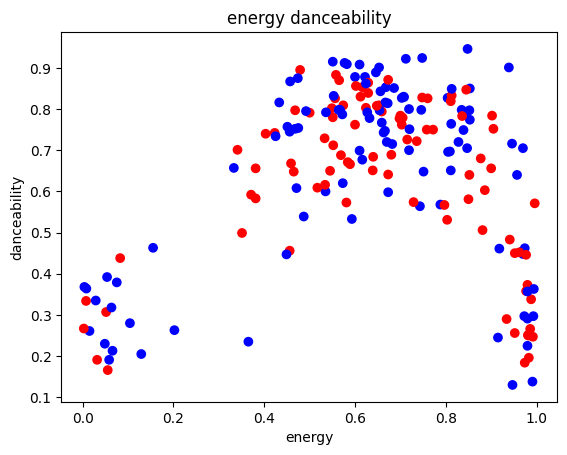

In [4]:
plot_scatter_2_features("energy" , "danceability")

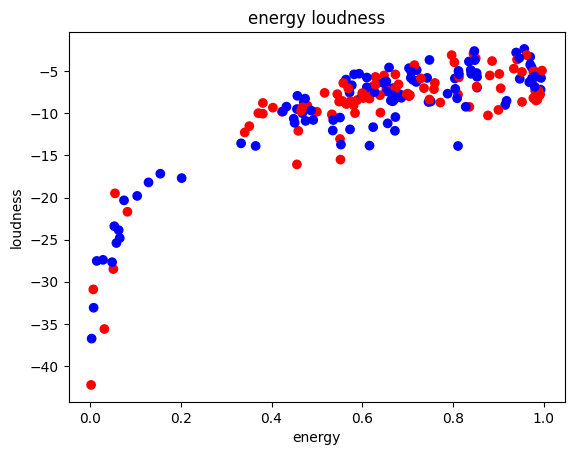

In [5]:
plot_scatter_2_features("energy" , "loudness")

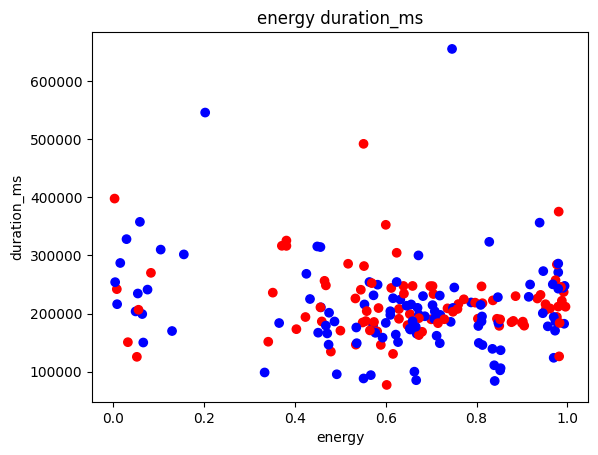

In [6]:
plot_scatter_2_features("energy" , "duration_ms")

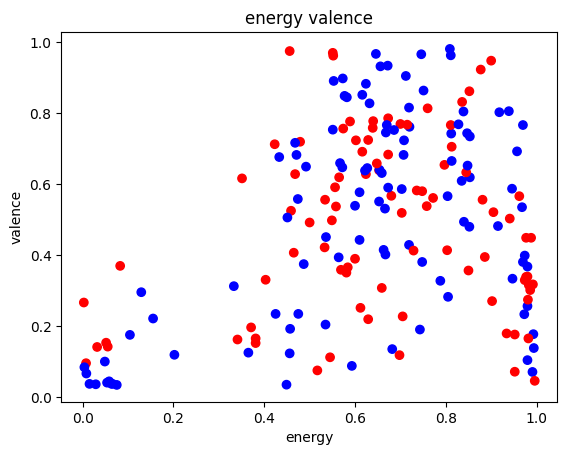

In [7]:
plot_scatter_2_features("energy" , "valence")

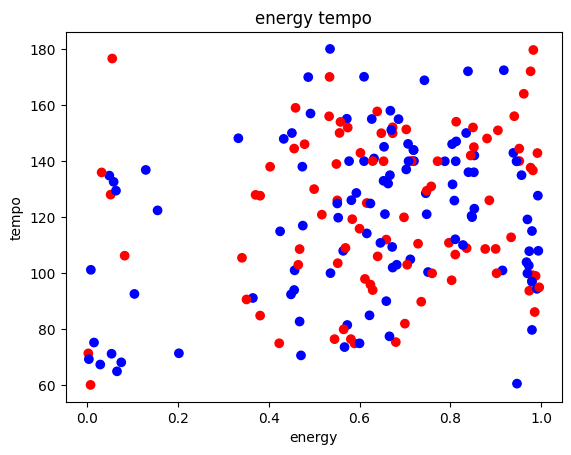

In [8]:
plot_scatter_2_features("energy" , "tempo")

In [9]:
plot_all_features()

### Statistical Measures

In [10]:
df.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liked
count,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000
mean,0.636656,0.638431,5.497436,-9.481631,0.538462,0.148957,0.319093,0.192337,0.148455,0.493632,121.086174,213408.933333,3.912821,0.512821
std,0.216614,0.260096,3.415209,6.525086,0.499802,0.120414,0.320782,0.346226,0.105975,0.267695,28.084829,72152.392864,0.451332,0.501122
min,0.130000,0.002400,0.000000,-42.261000,0.000000,0.027800,0.000003,0.000000,0.033100,0.035300,60.171000,77203.000000,1.000000,0.000000
25%,0.462500,0.533500,2.000000,-9.962000,0.000000,0.056800,0.042200,0.000000,0.084000,0.269000,100.242000,178300.500000,4.000000,0.000000
50%,0.705000,0.659000,6.000000,-7.766000,1.000000,0.096200,0.213000,0.000008,0.105000,0.525000,124.896000,204000.000000,4.000000,1.000000
75%,0.799000,0.837500,8.000000,-5.829000,1.000000,0.230500,0.504000,0.097500,0.177000,0.717500,142.460500,242373.500000,4.000000,1.000000
max,0.946000,0.996000,11.000000,-2.336000,1.000000,0.540000,0.995000,0.969000,0.633000,0.980000,180.036000,655213.000000,5.000000,1.000000


 # Visualize UMAP

### Retrieve Kmeans Cluster UMAP

In [6]:
dtypes = {
    "id" : int,
    "class" : int
}


engine = pg.connect(f"dbname='project_vector' user={postgres_user} host='127.0.0.1' port={port} password={postgres_pw}")
df_umap = pd.read_sql('select * from umap_classes', columns=["ID" , "class"] ,con=engine, dtype=dtypes)
df_umap.columns


engine.close()
df_umap

/tmp/ipykernel_57202/3221993036.py:8: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_umap = pd.read_sql('select * from umap_classes', columns=["ID" , "class"] ,con=engine, dtype=dtypes)


DatabaseError: Execution failed on sql 'select * from umap_classes': relation "umap_classes" does not exist
LINE 1: select * from umap_classes
                      ^


In [12]:
df["umap_classes"] = df_umap["class"]
df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liked,umap_classes
0,0.803,0.6240,7,-6.764,0,0.0477,0.4510,0.000734,0.1000,0.6280,95.968,304524,4,0,3
1,0.762,0.7030,10,-7.951,0,0.3060,0.2060,0.000000,0.0912,0.5190,151.329,247178,4,1,2
2,0.261,0.0149,1,-27.528,1,0.0419,0.9920,0.897000,0.1020,0.0382,75.296,286987,4,0,0
3,0.722,0.7360,3,-6.994,0,0.0585,0.4310,0.000001,0.1230,0.5820,89.860,208920,4,1,2
4,0.787,0.5720,1,-7.516,1,0.2220,0.1450,0.000000,0.0753,0.6470,155.117,179413,4,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,0.166,0.0551,9,-19.494,0,0.0520,0.9760,0.635000,0.1190,0.1430,176.616,206520,3,0,0
191,0.862,0.6240,3,-11.630,1,0.0565,0.0192,0.000153,0.0465,0.8820,124.896,254240,4,0,3
192,0.499,0.3510,9,-11.509,0,0.0448,0.9510,0.000099,0.1180,0.6160,90.664,235947,4,0,3
193,0.574,0.7290,10,-5.838,0,0.0965,0.0406,0.000004,0.1940,0.4130,110.547,190239,5,1,2


In [13]:
def plot_all_features_umap() -> None:

    fig, axs = plt.subplots(len(df.columns) , len(df.columns) , figsize=(150, 150)) # , sharex=True, sharey=True)
    cols = df.columns
    rows = df.columns
    colors = df["umap_classes"].values
    colors = colors.astype(str)
    colors[colors == "0" ] = "red"
    colors[colors == "1" ] = "blue"
    colors[colors == "2" ] = "green"
    colors[colors == "3" ] = "orange"
    colors[colors == "4" ] = "black"
    
    
    for ax, col in zip(axs[0], cols):
        ax.set_title(col)
    
    for ax, row in zip(axs[:,0], rows):
        ax.set_ylabel(row, rotation=90, size='large')
    
    for i in range(len(df.columns)):
        for j in range(len(df.columns)):
            axs[i,j].scatter(df[df.columns[i]], df[df.columns[j]] , c=colors)
            axs[i,j].set_ylabel(df.columns[j])
            axs[i,j].set_xlabel(df.columns[i])

    plt.title("UMAP Classes Comparison")
    plt.savefig("./all_scatterplots_umap.png" )


In [14]:
plot_all_features_umap()

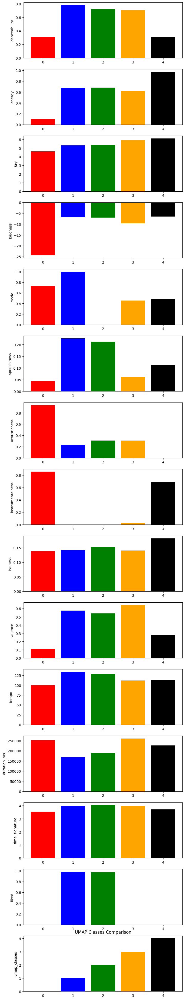

In [15]:
class_dfs = [df[(df["umap_classes"] == x )] for x in np.sort(df["umap_classes"].unique())]
result_umap_classes_df = pd.DataFrame()

means_ : list[list[float]] = []

fig, axs = plt.subplots(len(class_dfs[0].columns) , figsize=(8,50))

for i in range(len(class_dfs[0].columns)):
    y = []
    x = range(len(class_dfs))
    colors = ["red" , "blue" , "green" , "orange" , "black"]
    for class_df in class_dfs:
        y.append(class_df.describe()[class_dfs[0].columns[i]]["mean"])

    axs[i].bar(x, y , color=colors)
    axs[i].set_ylabel(class_dfs[0].columns[i])

plt.title("UMAP Classes Comparison")
plt.savefig("./umap_classes_comparison.png" )
plt.show()


In [16]:
df["umap_classes"].unique()

array([3, 2, 0, 1, 4])

# Visualize t-SNE

### Retrieve Kmeans Cluster t-SNE

In [17]:
dtypes = {
    "id" : int,
    "class" : int
}


engine = pg.connect(f"dbname='project_vector' user={postgres_user} host='127.0.0.1' port='5432' password={postgres_pw}")
df_tsne = pd.read_sql('select * from tsne_classes', columns=["ID" , "class"] ,con=engine, dtype=dtypes)
df_tsne.columns


engine.close()
df_tsne

/tmp/ipykernel_42223/4036619981.py:8: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_tsne = pd.read_sql('select * from tsne_classes', columns=["ID" , "class"] ,con=engine, dtype=dtypes)


,id,class
0,1,4
1,2,3
2,3,0
3,4,3
4,5,1
...,...,...
190,191,0
191,192,4
192,193,4
193,194,3


In [18]:
df["tsne_classes"] = df_tsne["class"]
df.head(30)

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liked,umap_classes,tsne_classes
0,0.803,0.6240,7,-6.764,0,0.0477,0.451000,0.000734,0.1000,0.6280,95.968,304524,4,0,3,4
1,0.762,0.7030,10,-7.951,0,0.3060,0.206000,0.000000,0.0912,0.5190,151.329,247178,4,1,2,3
2,0.261,0.0149,1,-27.528,1,0.0419,0.992000,0.897000,0.1020,0.0382,75.296,286987,4,0,0,0
3,0.722,0.7360,3,-6.994,0,0.0585,0.431000,0.000001,0.1230,0.5820,89.860,208920,4,1,2,3
4,0.787,0.5720,1,-7.516,1,0.2220,0.145000,0.000000,0.0753,0.6470,155.117,179413,4,1,1,1
5,0.778,0.6320,8,-6.415,1,0.1250,0.040400,0.000000,0.0912,0.8270,140.951,224029,4,1,1,1
6,0.666,0.5890,0,-8.405,0,0.3240,0.555000,0.000000,0.1140,0.7760,74.974,146053,4,1,2,3
7,0.922,0.7120,7,-6.024,1,0.1710,0.077900,0.000040,0.1750,0.9040,104.964,161800,4,1,1,1
8,0.794,0.6590,7,-7.063,0,0.0498,0.143000,0.002240,0.0944,0.3080,112.019,247460,4,0,3,4
9,0.853,0.6680,3,-6.995,1,0.4470,0.263000,0.000000,0.1040,0.7450,157.995,165363,4,1,1,1


In [19]:
def plot_all_features_tsne() -> None:

    fig, axs = plt.subplots(len(df.columns) , len(df.columns) , figsize=(150, 150)) # , sharex=True, sharey=True)
    cols = df.columns
    rows = df.columns
    colors = df["tsne_classes"].values
    colors = colors.astype(str)
    colors[colors == "0" ] = "red"
    colors[colors == "1" ] = "blue"
    colors[colors == "2" ] = "green"
    colors[colors == "3" ] = "orange"
    colors[colors == "4" ] = "black"
    
    
    for ax, col in zip(axs[0], cols):
        ax.set_title(col)
    
    for ax, row in zip(axs[:,0], rows):
        ax.set_ylabel(row, rotation=90, size='large')
    
    for i in range(len(df.columns)):
        for j in range(len(df.columns)):
            axs[i,j].scatter(df[df.columns[i]], df[df.columns[j]] , c=colors)
            axs[i,j].set_ylabel(df.columns[j])
            axs[i,j].set_xlabel(df.columns[i])

    plt.title("t-SNE Classes Comparison")
    plt.savefig("./all_scatterplots_tsne.png" )


In [20]:
plot_all_features_tsne()

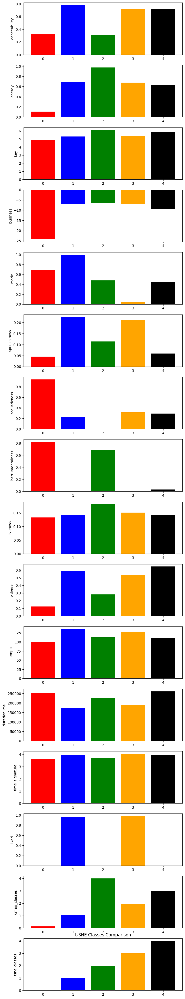

In [21]:
class_dfs = [df[(df["tsne_classes"] == x )] for x in np.sort(df["tsne_classes"].unique())]

fig, axs = plt.subplots(len(class_dfs[0].columns) , figsize=(8,50))

for i in range(len(class_dfs[0].columns)):
    y = []
    x = range(len(class_dfs))
    colors = ["red" , "blue" , "green" , "orange" , "black"]
    for class_df in class_dfs:
        y.append(class_df.describe()[class_dfs[0].columns[i]]["mean"])

    axs[i].bar(x, y , color=colors)
    axs[i].set_ylabel(class_dfs[0].columns[i])

plt.title("t-SNE Classes Comparison")
plt.savefig("./tsne_classes_comparison.png" )
plt.show()
